In [9]:
import os
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict
import cv2 as cv
# from scipy.ndimage.filters import sobel
from scipy.ndimage import sobel
import pathlib
from dotenv import load_dotenv

from ipywidgets import interact, widgets
from plotly.express import imshow as imshow_interactive

In [3]:
from template_match import read_image_rgb, read_image_gray, template_match, detect_points, find_tolerance_limit, simplify_points, agglomerative_clustering, meanshift_clustering
from process_template import template_tresholding

In [4]:
def draw_image(image: np.ndarray) -> None:
    plt.imshow(cv.cvtColor(image, cv.COLOR_BGR2RGB))


def draw_points_on_canvas(points: np.ndarray, image: np.ndarray) -> None:
    x = points[:, 0]
    y = points[:, 1]
    
    clear_canvas = image.copy()
    clear_canvas[:, :] = 255
    plt.scatter(x, y, alpha=0.5, s=5)
    plt.imshow(cv.cvtColor(clear_canvas, cv.COLOR_BGR2RGB))

In [5]:
BASE_DIR = pathlib.Path(__name__).resolve().parent.parent
load_dotenv(BASE_DIR / '.env')
DATA_PATH = pathlib.Path(os.getenv("DATA_PATH"))

In [14]:
template_path = "/mnt/c/Users/admin/Desktop/plot_digitization/_code/data/custom_diff_tests/plot6_marker1.png"
image_path = "/mnt/c/Users/admin/Desktop/plot_digitization/_code/data/plot10.png"


part1_path = "/mnt/c/Users/admin/Desktop/plot_digitization/_code/data/custom_diff_tests/part1.png"
part2_path = "/mnt/c/Users/admin/Desktop/plot_digitization/_code/data/custom_diff_tests/part2.png"

In [15]:
## Grayscale
template = read_image_gray(template_path)
part = read_image_gray(part1_path)

template_float = np.zeros_like(template, dtype=np.float64)
template_float[:, :] = template[:, :]

part_float = np.zeros_like(part, dtype=np.float64)
part_float[:, :] = part[:, :]

## RGB
template = read_image_rgb(template_path)
part = read_image_rgb(image_path)

template_float = np.zeros_like(template, dtype=np.float64)
template_float[:, :, :] = template[:, :, :]

part_float = np.zeros_like(part, dtype=np.float64)
part_float[:, :, :] = part[:, :, :]


## MAsk
mask = template_tresholding(template)
image_thesholded = template_tresholding(part)

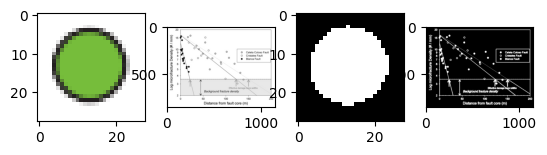

In [16]:
plt.subplot(1, 4, 1)
draw_image(template)

plt.subplot(1, 4, 2)
draw_image(part)

plt.subplot(1, 4, 3)
draw_image(mask)

plt.subplot(1, 4, 4)
draw_image(image_thesholded)

In [119]:
diff = diff_custom_gray(template_float, part_float, mask)

In [120]:
# np.unique(diff, return_counts=True)

In [128]:
indexes = np.where( diff < 600 )
y, x = indexes
# indexes

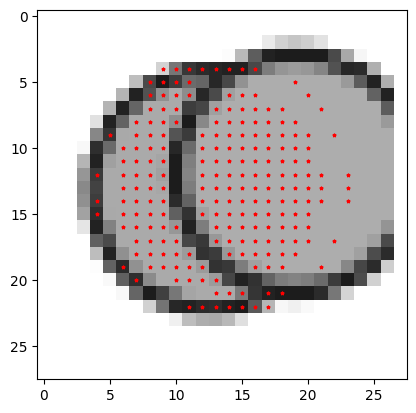

In [129]:
draw_image(part)
plt.scatter(x, y, s=5, c="red", marker="*")

In [16]:
np.where((template - part)**2 == 17)

(array([ 4,  5,  6, 11, 12, 17, 19]), array([16, 18,  8, 21,  3, 12, 14]))

In [18]:
res = (template - part)**2
res[4, 16]

17

In [20]:
template[4, 16], part[4, 16]

(95, 72)

In [24]:
(95 - 72)**2 - 256 - 256

17

In [118]:
def diff_custom_gray(template, image_part, mask):
    
    diff = (template - image_part)**2

    masked_indexes = np.where(mask == 0)
    diff[masked_indexes] = np.nan
    return diff

In [203]:
def diff_custom_rgb(template, image_part, mask):
    
    diff = np.zeros_like(template, dtype=np.float64)

    for channel in [0, 1, 2]:
        diff[:, :, channel] = (template[:, :, channel] - image_part[:, :, channel])**2

    masked_indexes = np.where(mask == 0)
    diff[masked_indexes] = np.nan
    return diff

In [204]:
diff_multichannel = diff_custom_rgb(template_float, part_float, mask)

diff = diff_multichannel[:, :, 0] + diff_multichannel[:, :, 1] + diff_multichannel[:, :, 2]

In [205]:
indexes = np.where( diff < 2000 )

y, x = indexes
# points = np.array([x, y]).T

In [206]:
matched_pixels_count = len(indexes[0])
total_pixels_count = len(np.where(mask == 255)[0])

matched_pixels_count, total_pixels_count


(149, 318)

In [207]:
match_probability = matched_pixels_count / total_pixels_count
match_probability

0.46855345911949686

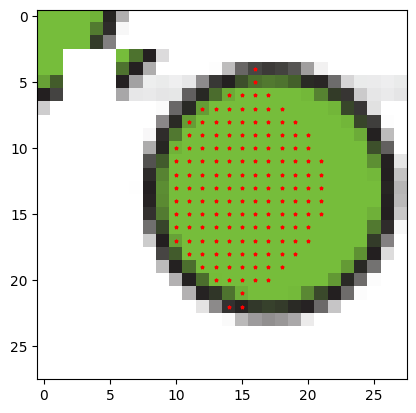

In [208]:
draw_image(part)
plt.scatter(x, y, s=5, c="red", marker="*")

## Mask-based Template matching

In [161]:
PLOT_NUMBER = 4
MARKER_NUMBER = 2

PLOT_PATH = DATA_PATH / f"plot{PLOT_NUMBER}.png"
TEMPLATE_PATH = DATA_PATH / "markers_same_shape" / f"plot{PLOT_NUMBER}_marker{MARKER_NUMBER}.png"

In [162]:
template_gray = read_image_gray(TEMPLATE_PATH)
image_gray = read_image_gray(PLOT_PATH)

template_rgb = read_image_rgb(TEMPLATE_PATH)
source_image = read_image_rgb(PLOT_PATH)
image_rgb = read_image_rgb(PLOT_PATH)  # here we will add mask


w, h = template_gray.shape[1], template_gray.shape[0]

In [163]:
mask = template_tresholding(template_gray)
image_tresholded = template_tresholding(image_gray)

In [164]:
# plt.imshow(image_tresholded)

In [165]:
indexes_background = np.where(image_tresholded == 0)

image_rgb[indexes_background] = 0

In [166]:
# plt.imshow(image_rgb)
# imshow_interactive(image_rgb)

In [167]:
method = 'cv.TM_CCORR_NORMED'
# method = 'cv.TM_SQDIFF_NORMED'
# method = 'cv.TM_SQDIFF'

convolution_map, max_val = template_match(image_rgb, template_rgb, mask, method_name=method)

In [169]:
nan_indexes = np.where( np.isnan(convolution_map) )
inf_indexes = np.where( np.isinf(convolution_map) )
convolution_map[nan_indexes] = 0
convolution_map[inf_indexes] = 0

if method == 'cv.TM_SQDIFF':
    convolution_map = convolution_map / np.max(convolution_map)


In [156]:
np.unique(convolution_map)

array([0.10456505, 0.10456508, 0.10456511, ..., 1.763627  , 1.7641244 ,
       2.        ], dtype=float32)

In [170]:
imshow_interactive(convolution_map)
# plt.imshow(convolution_map)

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'coloraxis': 'coloraxis',
              'hovertemplate': 'x: %{x}<br>y: %{y}<br>color: %{z}<extra></extra>',
              'name': '0',
              'type': 'heatmap',
              'xaxis': 'x',
              'yaxis': 'y',
              'z': array([[0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
                           0.0000000e+00, 0.0000000e+00],
                          [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
                           3.4788186e-09, 3.0587803e-09],
                          [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
                           1.4008328e-09, 4.0836914e-10],
                          ...,
                          [0.0000000e+00, 4.1032284e-09, 0.0000000e+00, ..., 0.0000000e+00,
                           1.0959279e-08, 0.0000000e+00],
                          [2.6887459e-09, 3.0043346e-09, 3.0007121e-09, ..., 5.1752149e-09,
                           3.0136480e-09, 0.0000000e+00],
                          [4.3898942e-09, 2.6350269e-09, 2.5754612e-09, ..., 1.2915633e-09,
                           5.4235412e-09, 2.6098954e-09]], dtype=float32)}],
    'layout': {'coloraxis': {'colorscale': [[0.0, '#0d0887'], [0.1111111111111111,
                                            '#46039f'], [0.2222222222222222,
                                            '#7201a8'], [0.3333333333333333,
                                            '#9c179e'], [0.4444444444444444,
                                            '#bd3786'], [0.5555555555555556,
                                            '#d8576b'], [0.6666666666666666,
                                            '#ed7953'], [0.7777777777777778,
                                            '#fb9f3a'], [0.8888888888888888,
                                            '#fdca26'], [1.0, '#f0f921']]},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y', 'constrain': 'domain', 'domain': [0.0, 1.0], 'scaleanchor': 'y'},
               'yaxis': {'anchor': 'x', 'autorange': 'reversed', 'constrain': 'domain', 'domain': [0.0, 1.0]}}
})

In [171]:
tolerance_limit = find_tolerance_limit(convolution_map)
tolerance_limit

0.211

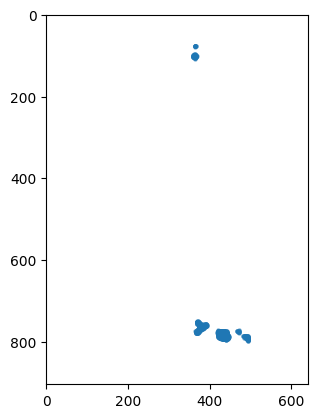

In [172]:
# run detection with limit tolerance value
max_val = np.max(convolution_map)
points = detect_points(convolution_map, max_val, tolerance=tolerance_limit)
draw_points_on_canvas(points, image_rgb)

In [173]:
@interact(tolerance=widgets.FloatSlider(value=0.001, min=0.001, max=tolerance_limit, step=0.001),
          eps=widgets.FloatSlider(value=0.1, min=0.1, max=10, step=0.1))
def visualize(tolerance, eps):

    points = detect_points(convolution_map, max_val, tolerance=tolerance)

    cluster_labels = meanshift_clustering(points, eps)
    # cluster_labels = agglomerative_clustering(points, eps)
    actual_points = simplify_points(points, cluster_labels)
    x = actual_points[:, 0]
    y = actual_points[:, 1]

    ## founded points on original image
    plt.figure(figsize=(10, 6))
    draw_image(source_image)
    x += w // 2 - 1
    y += h // 2 - 1
    plt.scatter(x, y, s=5, c="red", marker="*")
    plt.xticks([]); plt.yticks([]);
    plt.title(f"tolerance = {tolerance}")
    plt.show()
    
    ## founded points on clear canvas
    plt.figure(figsize=(10, 6))
    draw_points_on_canvas(actual_points, image_rgb)

interactive(children=(FloatSlider(value=0.001, description='tolerance', max=0.211, min=0.001, step=0.001), Flo…

In [109]:
@interact(tolerance=widgets.FloatSlider(value=0.001, min=0.001, max=tolerance_limit, step=0.001),
          eps=widgets.FloatSlider(value=0.1, min=0.1, max=10, step=0.1))
def visualize(tolerance, eps):

    points = detect_points(convolution_map, max_val, tolerance=tolerance)

    # cluster_labels = meanshift_clustering(points, eps)
    cluster_labels = agglomerative_clustering(points, eps)
    actual_points = simplify_points(points, cluster_labels)
    x = actual_points[:, 0]
    y = actual_points[:, 1]

    ## founded points on original image
    plt.figure(figsize=(10, 6))
    draw_image(source_image)
    x += w // 2 - 1
    y += h // 2 - 1
    plt.scatter(x, y, s=5, c="red", marker="*")
    plt.xticks([]); plt.yticks([]);
    plt.title(f"tolerance = {tolerance}")
    plt.show()
    
    ## founded points on clear canvas
    plt.figure(figsize=(10, 6))
    draw_points_on_canvas(actual_points, image_rgb)

interactive(children=(FloatSlider(value=0.001, description='tolerance', max=0.101, min=0.001, step=0.001), Flo…

In [69]:
@interact(tolerance=widgets.FloatSlider(value=100, min=100, max=100000, step=100),
          eps=widgets.FloatSlider(value=0.1, min=0.1, max=10, step=0.1))
def visualize(tolerance, eps):

    points = detect_points(convolution_map, max_val, tolerance=tolerance)

    # cluster_labels = meanshift_clustering(points, eps)
    cluster_labels = agglomerative_clustering(points, eps)
    actual_points = simplify_points(points, cluster_labels)
    x = actual_points[:, 0]
    y = actual_points[:, 1]

    ## founded points on original image
    plt.figure(figsize=(10, 6))
    draw_image(image_gray)
    x += w // 2 - 1
    y += h // 2 - 1
    plt.scatter(x, y, s=5, c="red", marker="*")
    plt.xticks([]); plt.yticks([]);
    plt.title(f"tolerance = {tolerance}")
    plt.show()
    
    ## founded points on clear canvas
    plt.figure(figsize=(10, 6))
    draw_points_on_canvas(actual_points, image_gray)

interactive(children=(FloatSlider(value=100.0, description='tolerance', max=100000.0, min=100.0, step=100.0), …